In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
import matplotlib.colors as mcolors
import pandas as pd 
import random
import math
import time
from sklearn.linear_model import LinearRegression, BayesianRidge
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
import datetime
# import operator 
# plt.style.use('seaborn-poster')
%matplotlib inline
# from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('retina')
import warnings
warnings.filterwarnings("ignore")
import os
import plotly.express as px

C:\Users\Roshan John\AppData\Local\Temp\ipykernel_16616\3378044940.py:18: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('retina')


In [2]:
conf_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')
deaths_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv')
recv_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv')
#latest_data = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports/07-12-2022.csv')
#us_medical_data = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports_us/07-12-2022.csv')

In [3]:
conf_df.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,9/2/22,9/3/22,9/4/22,9/5/22,9/6/22,9/7/22,9/8/22,9/9/22,9/10/22,9/11/22
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,193520,193912,194163,194355,194614,195012,195298,195471,195631,195925
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,329862,330062,330193,330221,330283,330516,330687,330842,330948,331036
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,270405,270426,270443,270461,270476,270489,270507,270522,270532,270539
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,46027,46027,46027,46027,46027,46113,46113,46113,46113,46113
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,102636,102636,102636,102636,102636,102636,102636,103131,103131,103131


In [4]:
conf_df.columns

Index(['Province/State', 'Country/Region', 'Lat', 'Long', '1/22/20', '1/23/20',
       '1/24/20', '1/25/20', '1/26/20', '1/27/20',
       ...
       '9/2/22', '9/3/22', '9/4/22', '9/5/22', '9/6/22', '9/7/22', '9/8/22',
       '9/9/22', '9/10/22', '9/11/22'],
      dtype='object', length=968)

In [5]:
conf_df.columns[4:]

Index(['1/22/20', '1/23/20', '1/24/20', '1/25/20', '1/26/20', '1/27/20',
       '1/28/20', '1/29/20', '1/30/20', '1/31/20',
       ...
       '9/2/22', '9/3/22', '9/4/22', '9/5/22', '9/6/22', '9/7/22', '9/8/22',
       '9/9/22', '9/10/22', '9/11/22'],
      dtype='object', length=964)

In [6]:
# extract dates
dates = conf_df.columns[4:]

# melt dataframes into longer format
# ==================================
conf_df_long = conf_df.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Confirmed')

deaths_df_long = deaths_df.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Deaths')

recv_df_long = recv_df.melt(id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
                            value_vars=dates, var_name='Date', value_name='Recovered')

recv_df_long = recv_df_long[recv_df_long['Country/Region']!='Canada']

print(conf_df_long.shape)
print(deaths_df_long.shape)
print(recv_df_long.shape)

(274740, 6)
(274740, 6)
(259316, 6)


In [7]:
# merge dataframes
# ================

full_table = pd.merge(left=conf_df_long, right=deaths_df_long, how='left',
                      on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long'])
full_table = pd.merge(left=full_table, right=recv_df_long, how='left',
                      on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long'])

full_table.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.93911,67.709953,1/22/20,0,0,0.0
1,NaN,Albania,41.15330,20.168300,1/22/20,0,0,0.0
2,NaN,Algeria,28.03390,1.659600,1/22/20,0,0,0.0
3,NaN,Andorra,42.50630,1.521800,1/22/20,0,0,0.0
4,NaN,Angola,-11.20270,17.873900,1/22/20,0,0,0.0


In [8]:
print(full_table.shape)

(274740, 8)


In [9]:
 full_table.isna()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
0,True,False,False,False,False,False,False,False
1,True,False,False,False,False,False,False,False
2,True,False,False,False,False,False,False,False
3,True,False,False,False,False,False,False,False
4,True,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...
274735,True,False,False,False,False,False,False,False
274736,True,False,False,False,False,False,False,False
274737,True,False,False,False,False,False,False,False
274738,True,False,False,False,False,False,False,False


In [10]:
full_table.isna().sum()

Province/State    188944
Country/Region         0
Lat                 1928
Long                1928
Date                   0
Confirmed              0
Deaths                 0
Recovered          20244
dtype: int64

In [11]:
 full_table.dtypes

Province/State     object
Country/Region     object
Lat               float64
Long              float64
Date               object
Confirmed           int64
Deaths              int64
Recovered         float64
dtype: object

In [12]:
# proper date format
full_table['Date'] = pd.to_datetime(full_table['Date'])

In [13]:
# fill na with 0
full_table['Recovered'] = full_table['Recovered'].fillna(0)

# convert to int datatype
full_table['Recovered'] = full_table['Recovered'].astype('int')

In [14]:
full_table.isna().sum()

Province/State    188944
Country/Region         0
Lat                 1928
Long                1928
Date                   0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64

In [15]:
# fixing Country names
# ====================

# renaming countries, regions, provinces
full_table['Country/Region'] = full_table['Country/Region'].replace('Korea, South', 'South Korea')

# Greenland
full_table.loc[full_table['Province/State']=='Greenland', 'Country/Region'] = 'Greenland'

# Mainland china to China
full_table['Country/Region'] = full_table['Country/Region'].replace('Mainland China', 'China')

In [16]:
# removing
# =======

# removing canada's recovered values
full_table = full_table[full_table['Province/State'].str.contains('Recovered')!=True]

# removing county wise data to avoid double counting
full_table = full_table[full_table['Province/State'].str.contains(',')!=True]

In [17]:
full_table.isna().sum()

Province/State    188944
Country/Region         0
Lat                 1928
Long                1928
Date                   0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64

In [18]:
# filling missing values 
# ======================
# fill missing province/state value with ''
full_table[['Province/State']] = full_table[['Province/State']].fillna('')
# fill missing numerical values with 0
cols = ['Confirmed', 'Deaths', 'Recovered']
full_table[cols] = full_table[cols].fillna(0)

# fixing datatypes
full_table['Recovered'] = full_table['Recovered'].astype(int)

# random rows
full_table.head(6)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
0,,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0
1,,Albania,41.15330,20.168300,2020-01-22,0,0,0
2,,Algeria,28.03390,1.659600,2020-01-22,0,0,0
3,,Andorra,42.50630,1.521800,2020-01-22,0,0,0
4,,Angola,-11.20270,17.873900,2020-01-22,0,0,0
5,,Antarctica,-71.94990,23.347000,2020-01-22,0,0,0


In [19]:
full_table.isna().sum()

Province/State       0
Country/Region       0
Lat               1928
Long              1928
Date                 0
Confirmed            0
Deaths               0
Recovered            0
dtype: int64

In [20]:
# Ship
# ====

# ship rows containing ships with COVID-19 reported cases
ship_rows = full_table['Province/State'].str.contains('Grand Princess') | \
            full_table['Province/State'].str.contains('Diamond Princess') | \
            full_table['Country/Region'].str.contains('Diamond Princess') | \
            full_table['Country/Region'].str.contains('MS Zaandam')

# ship
ship = full_table[ship_rows]

# Latest cases from the ships
ship_latest = ship[ship['Date']==max(ship['Date'])]
# ship_latest.style.background_gradient(cmap='Pastel1_r')

# skipping rows with ships info
full_table = full_table[~(ship_rows)]

In [21]:
# save data (not groupped by dates)
#full_table.to_csv('CLEAN_NOT.csv', index=False)

In [22]:
datewise = full_table.groupby('Date').agg({"Confirmed": "sum", "Deaths": "sum", "Recovered": "sum"}).reset_index()
countrywise = full_table.groupby(['Country/Region', 'Date']).agg({"Confirmed": "sum", "Deaths": "sum", "Recovered": "sum"}).reset_index()

In [23]:
countrywise.to_csv('countrywise.csv')

In [24]:
if os.path.exists("CLEAN_YES.csv"):
  os.remove("CLEAN_YES.csv")
else:
  print("The file does not exist")

In [25]:
datewise.to_csv('CLEAN_YES.csv')

In [26]:
clean = pd.read_csv('CLEAN_YES.csv')

In [27]:
clean.head()

,Unnamed: 0,Date,Confirmed,Deaths,Recovered
0,0,2020-01-22,557,17,30
1,1,2020-01-23,657,18,32
2,2,2020-01-24,944,26,39
3,3,2020-01-25,1437,42,42
4,4,2020-01-26,2120,56,56


In [28]:
days_since_1_22 = np.array([i for i in range(len(dates))]).reshape(-1, 1)

In [29]:
total_confirmed_cases = clean[['Confirmed']].to_numpy()

In [30]:
total_deaths = clean[['Deaths']].to_numpy()

In [31]:
days_in_future = 10
future_forecast = np.array([i for i in range(len(dates)+days_in_future)]).reshape(-1, 1)
adjusted_dates = future_forecast[:-10]

In [32]:
# Convert all the integers into datetime for better visualization

start = '1/22/2020'
start_date = datetime.datetime.strptime(start, '%m/%d/%Y')
future_forecast_dates = []
for i in range(len(future_forecast)):
    future_forecast_dates.append((start_date + datetime.timedelta(days=i)).strftime('%m/%d/%Y'))

In [33]:
# slightly modify the data to fit the model better (regression models cannot pick the pattern)

#days_to_skip = 500
X_train_confirmed, X_test_confirmed, y_train_confirmed, y_test_confirmed = train_test_split(days_since_1_22, total_confirmed_cases, test_size=0.20, shuffle=True) 


In [34]:
# svm_confirmed = svm_search.best_estimator_
svm_confirmed = SVR(shrinking=True, kernel='poly',gamma=0.01, epsilon=1,degree=3, C=0.1)
svm_confirmed.fit(X_train_confirmed, y_train_confirmed)
svm_pred = svm_confirmed.predict(future_forecast)

MAE: 28672812.637458663
MSE: 1170965513158268.2


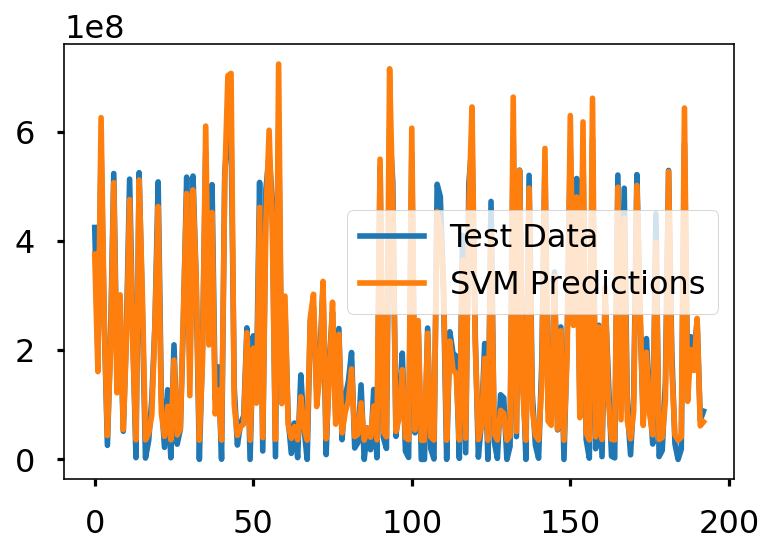

In [35]:
# check against testing data
svm_test_pred = svm_confirmed.predict(X_test_confirmed)
# plt.plot(y_test_confirmed)
# plt.plot(svm_test_pred)
plt.legend(['Test Data', 'SVM Predictions'])
print('MAE:', mean_absolute_error(svm_test_pred, y_test_confirmed))
print('MSE:',mean_squared_error(svm_test_pred, y_test_confirmed))

In [36]:
# transform our data for polynomial regression
poly = PolynomialFeatures(degree=3)
poly_X_train_confirmed = poly.fit_transform(X_train_confirmed)
poly_X_test_confirmed = poly.fit_transform(X_test_confirmed)
poly_future_forecast = poly.fit_transform(future_forecast)

bayesian_poly = PolynomialFeatures(degree=3)
bayesian_poly_X_train_confirmed = bayesian_poly.fit_transform(X_train_confirmed)
bayesian_poly_X_test_confirmed = bayesian_poly.fit_transform(X_test_confirmed)
bayesian_poly_future_forcast = bayesian_poly.fit_transform(future_forecast)

In [37]:
# polynomial regression
linear_model = LinearRegression(normalize=True, fit_intercept=False)
linear_model.fit(poly_X_train_confirmed, y_train_confirmed)
test_linear_pred = linear_model.predict(poly_X_test_confirmed)
linear_pred = linear_model.predict(poly_future_forecast)
print('MAE:', mean_absolute_error(test_linear_pred, y_test_confirmed))
print('MSE:',mean_squared_error(test_linear_pred, y_test_confirmed))

MAE: 15055101.426564794
MSE: 471312432308708.8


In [38]:
svm_confirmed.predict([[1000]])

array([8.11542595e+08])

In [39]:
print(linear_model.coef_)

[[-2.18934264e+06  5.70068017e+03  5.94734721e+02  1.07027318e-01]]


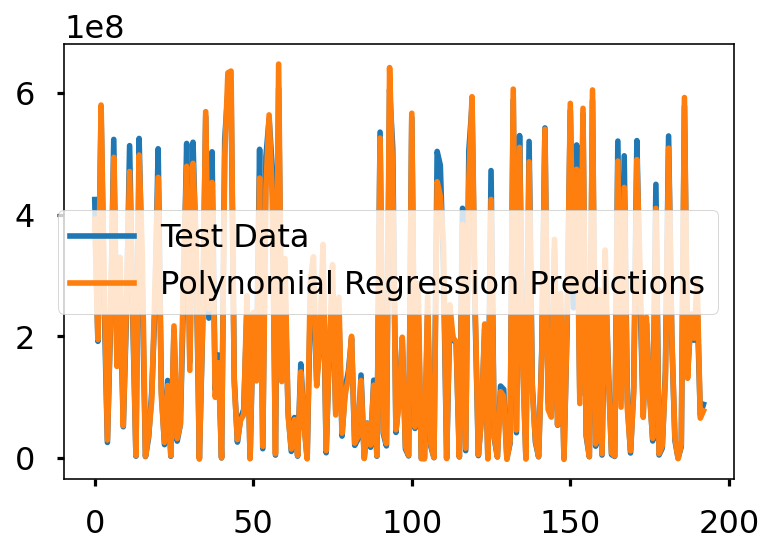

In [40]:
# plt.plot(y_test_confirmed)
# plt.plot(test_linear_pred)
# plt.legend(['Test Data', 'Polynomial Regression Predictions'])

In [41]:
# bayesian ridge polynomial regression
tol = [1e-6, 1e-5, 1e-4, 1e-3, 1e-2]
alpha_1 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
alpha_2 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
lambda_1 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
lambda_2 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
normalize = [True, False]

bayesian_grid = {'tol': tol, 'alpha_1': alpha_1, 'alpha_2' : alpha_2, 'lambda_1': lambda_1, 'lambda_2' : lambda_2, 
                 'normalize' : normalize}

bayesian = BayesianRidge(fit_intercept=False)
bayesian_search = RandomizedSearchCV(bayesian, bayesian_grid, scoring='neg_mean_squared_error', cv=3, return_train_score=True, n_jobs=-1, n_iter=40, verbose=1)
bayesian_search.fit(bayesian_poly_X_train_confirmed, y_train_confirmed)

Fitting 3 folds for each of 40 candidates, totalling 120 fits


RandomizedSearchCV(cv=3, estimator=BayesianRidge(fit_intercept=False),
                   n_iter=40, n_jobs=-1,
                   param_distributions={'alpha_1': [1e-07, 1e-06, 1e-05, 0.0001,
                                                    0.001],
                                        'alpha_2': [1e-07, 1e-06, 1e-05, 0.0001,
                                                    0.001],
                                        'lambda_1': [1e-07, 1e-06, 1e-05,
                                                     0.0001, 0.001],
                                        'lambda_2': [1e-07, 1e-06, 1e-05,
                                                     0.0001, 0.001],
                                        'normalize': [True, False],
                                        'tol': [1e-06, 1e-05, 0.0001, 0.001,
                                                0.01]},
                   return_train_score=True, scoring='neg_mean_squared_error',
                   verbose=1)

In [42]:
bayesian_search.best_params_

{'tol': 1e-06,
 'normalize': True,
 'lambda_2': 0.0001,
 'lambda_1': 1e-07,
 'alpha_2': 0.0001,
 'alpha_1': 0.001}

In [43]:
bayesian_confirmed = bayesian_search.best_estimator_
test_bayesian_pred = bayesian_confirmed.predict(bayesian_poly_X_test_confirmed)
bayesian_pred = bayesian_confirmed.predict(bayesian_poly_future_forcast)
print('MAE:', mean_absolute_error(test_bayesian_pred, y_test_confirmed))
print('MSE:',mean_squared_error(test_bayesian_pred, y_test_confirmed))

MAE: 15255857.967923604
MSE: 471312714516733.2


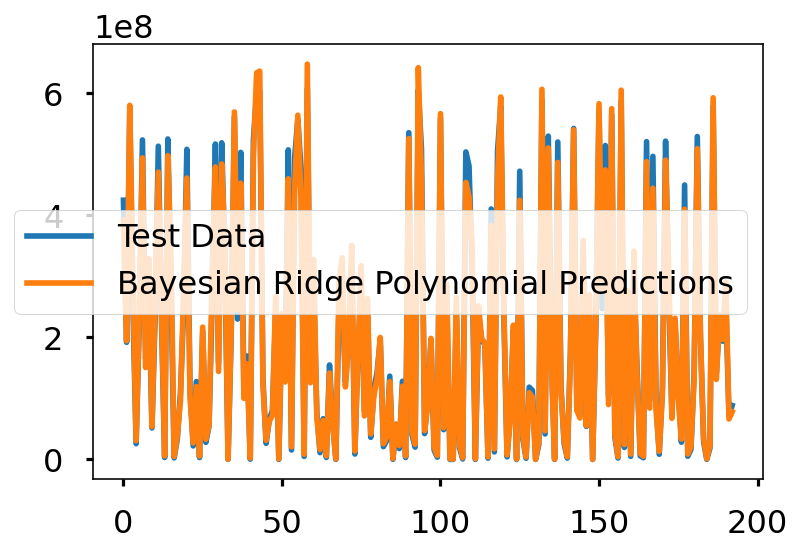

In [44]:
plt.plot(y_test_confirmed)
plt.plot(test_bayesian_pred)
plt.legend(['Test Data', 'Bayesian Ridge Polynomial Predictions'])

In [45]:
def plot_predictions(x, y, pred, algo_name, color):
    plt.figure(figsize=(12, 8))
    plt.plot(x, y)
    plt.plot(future_forecast, pred, linestyle='dashed', color=color)
    plt.title('Worldwide Coronavirus Cases Over Time', size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.legend(['Confirmed Cases', algo_name], prop={'size': 20})
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

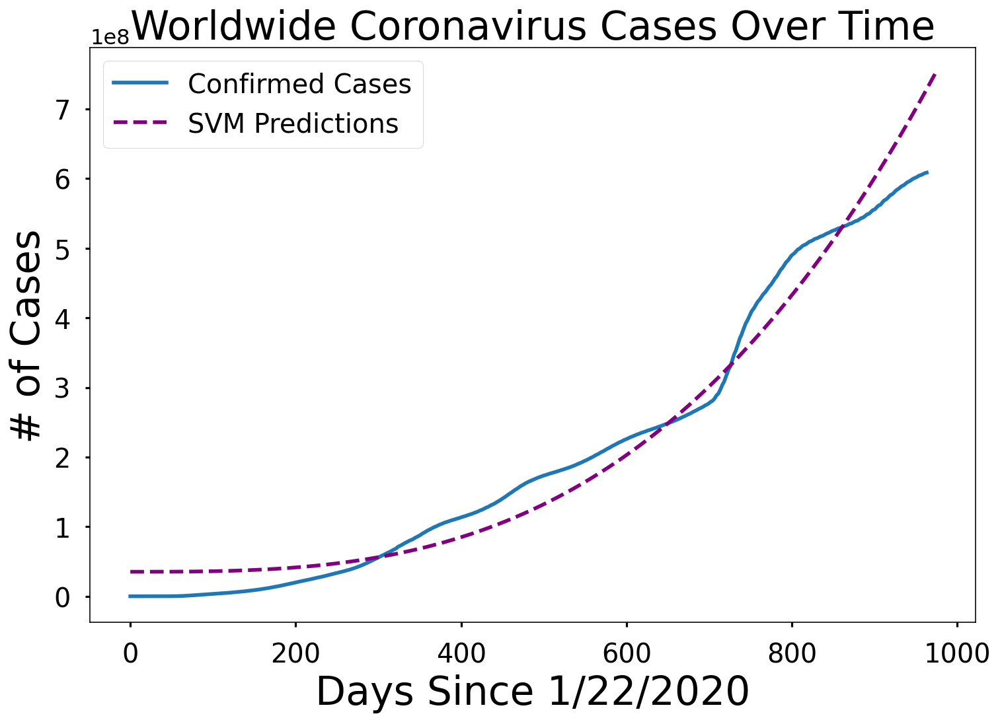

In [46]:
plot_predictions(adjusted_dates, total_confirmed_cases, svm_pred, 'SVM Predictions', 'purple')

In [47]:
import pickle

with open('./Flask/application/conf_model.pkl', 'wb') as file:
    pickle.dump(svm_confirmed, file)

In [48]:
# Future predictions using SVM 
svm_df = pd.DataFrame({'Date': future_forecast_dates[-10:], 'SVM Predicted # of Confirmed Cases Worldwide': np.round(svm_pred[-10:])})
svm_df.style.background_gradient(cmap='Reds')

,Date,SVM Predicted # of Confirmed Cases Worldwide
0,09/12/2022,730679268.000000
1,09/13/2022,732845884.000000
2,09/14/2022,735016996.000000
3,09/15/2022,737192607.000000
4,09/16/2022,739372722.000000
5,09/17/2022,741557346.000000
6,09/18/2022,743746484.000000
7,09/19/2022,745940141.000000
8,09/20/2022,748138320.000000
9,09/21/2022,750341027.000000


In [49]:
# Future predictions using polynomial regression
linear_pred = linear_pred.reshape(1,-1)[0]
linear_df = pd.DataFrame({'Date': future_forecast_dates[-10:], 'Polynomial Predicted # of Confirmed Cases Worldwide': np.round(linear_pred[-10:])})
linear_df.style.background_gradient(cmap='Reds')

,Date,Polynomial Predicted # of Confirmed Cases Worldwide
0,09/12/2022,651870206.000000
1,09/13/2022,653321840.000000
2,09/14/2022,654775283.000000
3,09/15/2022,656230535.000000
4,09/16/2022,657687598.000000
5,09/17/2022,659146473.000000
6,09/18/2022,660607159.000000
7,09/19/2022,662069657.000000
8,09/20/2022,663533968.000000
9,09/21/2022,665000093.000000


In [50]:
# Future predictions using Bayesian Ridge 
bayesian_df = pd.DataFrame({'Date': future_forecast_dates[-10:], 'Bayesian Ridge Predicted # of Confirmed Cases Worldwide': np.round(bayesian_pred[-10:])})
bayesian_df.style.background_gradient(cmap='Reds')

,Date,Bayesian Ridge Predicted # of Confirmed Cases Worldwide
0,09/12/2022,652470175.000000
1,09/13/2022,653928531.000000
2,09/14/2022,655388722.000000
3,09/15/2022,656850749.000000
4,09/16/2022,658314612.000000
5,09/17/2022,659780313.000000
6,09/18/2022,661247853.000000
7,09/19/2022,662717231.000000
8,09/20/2022,664188448.000000
9,09/21/2022,665661506.000000


In [51]:
# r2 score

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
r2 = r2_score(y_test_confirmed, test_bayesian_pred)
print(f"r2 score = {r2}")      

r2 score = 0.9875531353236144


In [52]:
r2 = r2_score(y_test_confirmed, svm_test_pred)
print(f"r2 score = {r2}")  

r2 score = 0.96907605325704


In [53]:
r2 = r2_score(y_test_confirmed, test_linear_pred)
print(f"r2 score = {r2}")  

r2 score = 0.9875531427764265


In [54]:
total_death_cases = clean[['Deaths']].to_numpy()

In [55]:
# slightly modify the data to fit the model better (regression models cannot pick the pattern)

#days_to_skip = 500
X_train_confirmed, X_test_confirmed, y_train_confirmed, y_test_confirmed = train_test_split(days_since_1_22, total_death_cases, test_size=0.20, shuffle=True) 


In [56]:
svm_deaths = SVR(shrinking=True, kernel='poly',gamma=0.01, epsilon=1,degree=3, C=0.1)
svm_deaths.fit(X_train_confirmed, y_train_confirmed)

SVR(C=0.1, epsilon=1, gamma=0.01, kernel='poly')

MAE: 958019.1929408883
MSE: 1196196119019.464


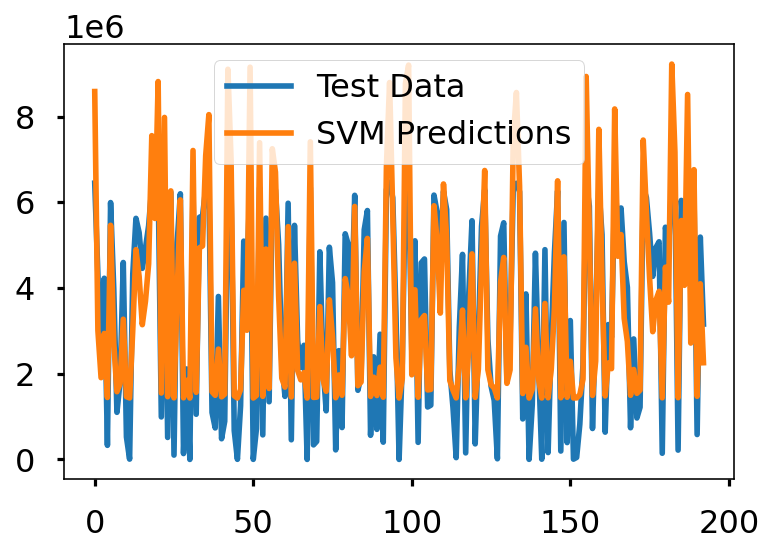

In [57]:
svm_test_pred = svm_deaths.predict(X_test_confirmed)
# plt.plot(y_test_confirmed)
# plt.plot(svm_test_pred)
# plt.legend(['Test Data', 'SVM Predictions'])
print('MAE:', mean_absolute_error(svm_test_pred, y_test_confirmed))
print('MSE:',mean_squared_error(svm_test_pred, y_test_confirmed))

In [58]:
r2 = r2_score(y_test_confirmed, svm_test_pred)
print(f"r2 score = {r2}") 

r2 score = 0.7789370285064885


In [59]:
import pickle

with open('./Flask/applicaton/deaths_model.pkl', 'wb') as file:
    pickle.dump(svm_deaths, file)

In [60]:
countrywise = full_table.groupby(['Country/Region', 'Date']).agg({"Confirmed": "sum", "Deaths": "sum", "Recovered": "sum"}).reset_index()

In [61]:
datewise['date_str'] = datewise['Date'].apply(lambda x: str(x))
countrywise['date_str'] = countrywise['Date'].apply(lambda x: str(x))

In [62]:
fig = px.choropleth(data_frame=countrywise, locations='Country/Region', locationmode='country names', color='Confirmed',animation_frame='date_str')


# # fig = px.choropleth(countrywise,locations='Country/Region',locationmode='country names',color='Confirmed',animation_frame='Date')
fig.update_layout(title='Choropleth Map of Confirmed Cases -till today',template="plotly_dark")
fig.show()

In [63]:
fig = px.choropleth(data_frame=countrywise, locations='Country/Region', locationmode='country names', color='Deaths',animation_frame='date_str')


# # fig = px.choropleth(countrywise,locations='Country/Region',locationmode='country names',color='Confirmed',animation_frame='Date')
fig.update_layout(title='Choropleth Map of Deaths Cases -till today',template="plotly_dark")
fig.show()

In [64]:
fig=px.line(datewise,x="Date",y=["Confirmed","Deaths"],title="covid cases w.r.t. date",template="plotly_dark")
fig.show()


In [65]:
world_data=pd.read_csv('worldometer_data.csv')

In [66]:
world_data.columns

Index(['Country,Other', 'TotalCases', 'NewCases', 'TotalDeaths', 'NewDeaths',
       'TotalRecovered', 'NewRecovered', 'ActiveCases', 'Serious,Critical',
       'Tot Cases/1M pop', 'Deaths/1M pop', 'TotalTests', 'Tests/\n1M pop\n',
       'Population', 'Continent', '1 Caseevery X ppl', '1 Deathevery X ppl',
       '1 Testevery X ppl'],
      dtype='object')

In [67]:
fig=px.bar(world_data.iloc[0:20],x='Country,Other',y='TotalCases',color='TotalCases',text="TotalCases")
fig.update_layout(template="plotly_dark",title_text="<b>Top 20 countries of Total confirmed cases</b>")
fig.show()

In [68]:
fig=px.bar(world_data.sort_values(by='TotalDeaths',ascending=False)[0:20],x='Country,Other',y='TotalDeaths',color='TotalDeaths',text="TotalDeaths")
fig.update_layout(template="plotly_dark",title_text="<b>Top 20 countries of Total deaths</b>")
fig.show()

In [69]:
fig=px.bar(world_data.sort_values(by='TotalRecovered',ascending=False)[:20],x='Country,Other',y='TotalRecovered',color='TotalRecovered',text='TotalRecovered')
fig.update_layout(template="plotly_dark",title_text="<b>Top 20 countries of Total Recovered")
fig.show()

In [70]:
fig=px.bar(world_data.sort_values(by='ActiveCases',ascending=False)[0:20], x='Country,Other',y='ActiveCases',color='ActiveCases',text='ActiveCases')
fig.update_layout(template="plotly_dark",title_text="<b>Top 20 countries of Total Active cases")
fig.show()

In [71]:
world_data["TotalCases"] = world_data["TotalCases"].str.replace(',', '').astype(float)

In [72]:
labels=world_data[0:15]['Country,Other'].values
cases=['TotalCases','TotalDeaths','TotalRecovered','ActiveCases']
for i in cases:
    fig=px.pie(world_data[0:15],values=i,names=labels,template="plotly_dark",hole=0.3,title=" {} Recordeded w.r.t. to WHO Region of 15 worst effected countries ".format(i))
    fig.show()